# WeatherPy
----

#### Note
* Instructions have been included for each segment. You do not have to follow them exactly, but they are included to help you think through the steps.

In [1]:
# Dependencies and Setup
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import requests
import time
from scipy.stats import linregress

# Import API key
from api_keys import weather_api

# Incorporated citipy to determine city based on latitude and longitude
from citipy import citipy

# Range of latitudes and longitudes
lat_range = (-90, 90)
lng_range = (-180, 180)

## Generate Cities List

In [2]:
# List for holding lat_lngs and cities
lat_lngs = []
cities = []

# Create a set of random lat and lng combinations
lats = np.random.uniform(lat_range[0], lat_range[1], size=1500)
lngs = np.random.uniform(lng_range[0], lng_range[1], size=1500)
lat_lngs = zip(lats, lngs)

# Identify nearest city for each lat, lng combination
for lat_lng in lat_lngs:
    city = citipy.nearest_city(lat_lng[0], lat_lng[1]).city_name
    
    # If the city is unique, then add it to a our cities list
    if city not in cities:
        cities.append(city)

# Print the city count to confirm sufficient count
len(cities)

612

### Perform API Calls
* Perform a weather check on each city using a series of successive API calls.
* Include a print log of each city as it'sbeing processed (with the city number and city name).


In [3]:
# URL
url = "http://api.openweathermap.org/data/2.5/weather?"

# Build partial query URL
units = "imperial"
query_url = f"{url}appid={weather_api}&units={units}&q="

# Set up list to hold reponses
responses = []

# Loop through the list of cities and perform a request for data on each
for city in cities:
    response = requests.get(query_url + city).json()
    responses.append(response)
    print (responses)

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}]
[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

[{'coord': {'lon': -93.8667, 'lat': 16.0333}, 'weather': [{'id': 804, 'main': 'Clouds', 'description': 'overcast clouds', 'icon': '04n'}], 'base': 'stations', 'main': {'temp': 77.41, 'feels_like': 78.85, 'temp_min': 77.41, 'temp_max': 77.41, 'pressure': 1010, 'humidity': 85, 'sea_level': 1010, 'grnd_level': 1010}, 'visibility': 10000, 'wind': {'speed': 10.18, 'deg': 331, 'gust': 11.86}, 'clouds': {'all': 100}, 'dt': 1627638811, 'sys': {'country': 'MX', 'sunrise': 1627646172, 'sunset': 1627692444}, 'timezone': -18000, 'id': 3521894, 'name': 'Paredon', 'cod': 200}, {'coord': {'lon': -16.7339, 'lat': 13.2019}, 'weather': [{'id': 803, 'main': 'Clouds', 'description': 'broken clouds', 'icon': '04d'}], 'base': 'stations', 'main': {'temp': 80.67, 'feels_like': 86.22, 'temp_min': 80.67, 'temp_max': 80.67, 'pressure': 1013, 'humidity': 83}, 'visibility': 10000, 'wind': {'speed': 9.22, 'deg': 270}, 'clouds': {'all': 75}, 'dt': 1627638811, 'sys': {'type': 1, 'id': 2367, 'country': 'GM', 'sunrise'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [4]:
print(cities)

['paredon', 'gunjur', 'kapaa', 'bargal', 'woodward', 'port elizabeth', 'dhidhdhoo', 'amarwara', 'busselton', 'tucuma', 'san juan', 'vaini', 'bonavista', 'galgani', 'kulu', 'bambous virieux', 'vila franca do campo', 'hobart', 'albany', 'hithadhoo', 'isangel', 'chicama', 'punta arenas', 'pangnirtung', 'rikitea', 'port alfred', 'rio grande', 'butaritari', 'geresk', 'sao filipe', 'mataura', 'buenos aires', 'puerto ayora', 'okakarara', 'vidim', 'santa cruz', 'bluff', 'riyadh', 'victoria', 'illoqqortoormiut', 'qasigiannguit', 'berdigestyakh', 'bolonchen', 'jamestown', 'beian', 'pevek', 'coos bay', 'cape town', 'geraldton', 'karaul', 'malaut', 'west bay', 'nanortalik', 'umm lajj', 'atuona', 'grindavik', 'teknaf', 'temyasovo', 'nurota', 'prigorodka', 'sabang', 'huron', 'arlit', 'cayenne', 'hovd', 'hermanus', 'bam', 'tura', 'tiksi', 'maidenhead', 'muli', 'bengkulu', 'port hedland', 'diffa', 'rawson', 'nikolskoye', 'khatanga', 'arraial do cabo', 'kattivakkam', 'saint-francois', 'cherskiy', 'mend

### Convert Raw Data to DataFrame
* Export the city data into a .csv.
* Display the DataFrame

In [5]:
# Dump responses into a DataFrame
raw_df = pd.json_normalize(responses)
raw_df.head(5)

,weather,base,visibility,dt,timezone,id,name,cod,coord.lon,coord.lat,...,wind.gust,clouds.all,sys.country,sys.sunrise,sys.sunset,sys.type,sys.id,rain.1h,message,snow.1h
0,"[{'id': 804, 'main': 'Clouds', 'description': ...",stations,10000.0,1.627639e+09,-18000.0,3521894.0,Paredon,200,-93.8667,16.0333,...,11.86,100.0,MX,1.627646e+09,1.627692e+09,NaN,NaN,NaN,NaN,NaN
1,"[{'id': 803, 'main': 'Clouds', 'description': ...",stations,10000.0,1.627639e+09,0.0,2413419.0,Gunjur,200,-16.7339,13.2019,...,NaN,75.0,GM,1.627628e+09,1.627674e+09,1.0,2367.0,NaN,NaN,NaN
2,"[{'id': 500, 'main': 'Rain', 'description': 'l...",stations,10000.0,1.627639e+09,-36000.0,5848280.0,Kapaa,200,-159.3190,22.0752,...,3.00,96.0,US,1.627575e+09,1.627622e+09,2.0,2001562.0,0.89,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,404,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,city not found,NaN
4,"[{'id': 800, 'main': 'Clear', 'description': '...",stations,10000.0,1.627639e+09,-18000.0,4556050.0,Woodward,200,-99.3904,36.4337,...,NaN,1.0,US,1.627645e+09,1.627696e+09,1.0,6275.0,NaN,NaN,NaN


In [6]:
# Export file as a CSV, without the Pandas index, but with the header
raw_df.to_csv("../Resources/raw_df.csv", index=False, header=True)

In [7]:
# Select columns
df_1 = raw_df[['name', 'coord.lat', 'coord.lon','main.temp_max' ,'main.humidity','clouds.all','wind.speed','sys.country','dt']]
df_1.columns = ['City', 'Lat', 'Lng', 'Max Temp','Humidity','Cloudiness','Wind Speed','Country','Date']
df_2 = df_1.dropna()
df_2

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,Paredon,16.0333,-93.8667,77.41,85.0,100.0,10.18,MX,1.627639e+09
1,Gunjur,13.2019,-16.7339,80.67,83.0,75.0,9.22,GM,1.627639e+09
2,Kapaa,22.0752,-159.3190,75.11,59.0,96.0,1.01,US,1.627639e+09
4,Woodward,36.4337,-99.3904,74.73,83.0,1.0,0.00,US,1.627639e+09
5,Port Elizabeth,-33.9180,25.5701,68.09,67.0,0.0,6.91,ZA,1.627639e+09
...,...,...,...,...,...,...,...,...,...
607,Mapiri,-15.2500,-68.1667,55.18,93.0,100.0,0.02,BO,1.627639e+09
608,Vila,42.0304,-8.1588,65.75,65.0,11.0,4.68,PT,1.627639e+09
609,Azul,-36.7770,-59.8585,35.83,63.0,0.0,7.63,AR,1.627639e+09
610,Tefé,-3.3542,-64.7114,68.81,75.0,76.0,2.98,BR,1.627639e+09


In [8]:
df_2.describe()

,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Date
count,561.000000,561.000000,561.000000,561.000000,561.000000,561.000000,5.610000e+02
mean,19.661085,18.736544,70.725437,67.192513,51.696970,7.838146,1.627639e+09
std,33.713226,90.179826,15.525630,22.707268,39.265681,5.470947,4.995908e+01
min,-54.800000,-175.200000,25.720000,8.000000,0.000000,0.000000,1.627639e+09
25%,-9.012200,-58.736800,61.050000,53.000000,7.000000,3.760000,1.627639e+09
50%,22.788600,20.441700,73.270000,73.000000,56.000000,6.670000,1.627639e+09
75%,48.000000,100.354300,81.730000,85.000000,91.000000,11.030000,1.627639e+09
max,78.218600,179.316700,111.540000,100.000000,100.000000,30.560000,1.627639e+09


## Inspect the data and remove the cities where the humidity > 100%.
----
Skip this step if there are no cities that have humidity > 100%. 

In [9]:
# There is no cities that have humidity > 100%.

In [10]:
# Make a new DataFrame equal to the city data to drop all humidity outliers by index.
# Passing "inplace=False" will make a copy of the city_data DataFrame, which we call "clean_city_data".

In [11]:
clean_city_data = df_2
clean_city_data.head(5)

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,Paredon,16.0333,-93.8667,77.41,85.0,100.0,10.18,MX,1.627639e+09
1,Gunjur,13.2019,-16.7339,80.67,83.0,75.0,9.22,GM,1.627639e+09
2,Kapaa,22.0752,-159.3190,75.11,59.0,96.0,1.01,US,1.627639e+09
4,Woodward,36.4337,-99.3904,74.73,83.0,1.0,0.00,US,1.627639e+09
5,Port Elizabeth,-33.9180,25.5701,68.09,67.0,0.0,6.91,ZA,1.627639e+09


In [12]:
# Export file as a CSV, without the Pandas index, but with the header
clean_city_data.to_csv("../Resources/clean_city_data.csv", index=False, header=True)


## Plotting the Data
* Use proper labeling of the plots using plot titles (including date of analysis) and axes labels.
* Save the plotted figures as .pngs.

In [13]:
# Select columns
scatter_df = clean_city_data[['Lat', 'Max Temp', 'Humidity','Cloudiness' ,'Wind Speed','Date']]
scatter_df.columns = ["Lattitude", "Max Temperature (F)", "Humidity (%)", "Cloudiness (%)", "Wind Speed (mph)",'Date']
scatter_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph),Date
0,16.0333,77.41,85.0,100.0,10.18,1.627639e+09
1,13.2019,80.67,83.0,75.0,9.22,1.627639e+09
2,22.0752,75.11,59.0,96.0,1.01,1.627639e+09
4,36.4337,74.73,83.0,1.0,0.00,1.627639e+09
5,-33.9180,68.09,67.0,0.0,6.91,1.627639e+09
...,...,...,...,...,...,...
607,-15.2500,55.18,93.0,100.0,0.02,1.627639e+09
608,42.0304,65.75,65.0,11.0,4.68,1.627639e+09
609,-36.7770,35.83,63.0,0.0,7.63,1.627639e+09
610,-3.3542,68.81,75.0,76.0,2.98,1.627639e+09


In [14]:
Date = scatter_df['Date'].max()
Date

1627638870.0

In [15]:
print(Date)

1627638870.0


## Latitude vs. Temperature Plot

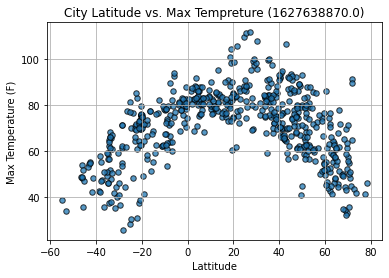

In [16]:
# Create a scatter plot which compares Max Temperature (F) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Max Temperature (F)",marker="o", facecolors="blue",
edgecolors="black", s=30,alpha=0.75,figsize=(6,4), title=f"City Latitude vs. Max Tempreture ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Temperature Plot.png", bbox_inches = "tight")

## Latitude vs. Humidity Plot

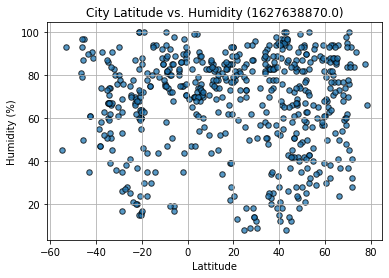

In [17]:
# Create a scatter plot which Humidity (%) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Humidity (%)",marker="o", facecolors="blue",
edgecolors="black", s=30,alpha=0.75, 
figsize=(6,4), title=f"City Latitude vs. Humidity ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Humidity_Plot.png", bbox_inches = "tight")

## Latitude vs. Cloudiness Plot

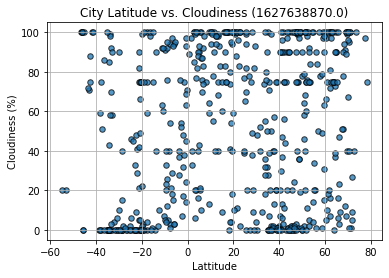

In [18]:
# Create a scatter plot which Cloudiness (%) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Cloudiness (%)",marker="o", facecolors="blue",
edgecolors="black", s=30,alpha=0.75, 
figsize=(6,4), title=f"City Latitude vs. Cloudiness ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Cloudiness_Plot.png", bbox_inches = "tight")

## Latitude vs. Wind Speed Plot

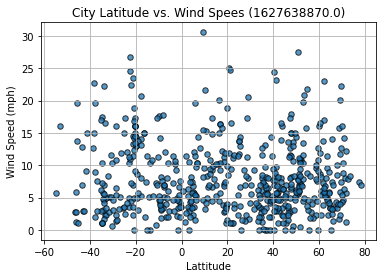

In [19]:
# Create a scatter plot which compares Wind Speed (mph) vs. Latitude
scatter_df.plot(kind="scatter", x="Lattitude", y="Wind Speed (mph)",marker="o", facecolors="blue",
edgecolors="black",alpha=0.75, s=30, 
figsize=(6,4), title=f"City Latitude vs. Wind Spees ({Date})")
plt.grid(True)
plt.savefig("../Images/Latitude_vs._Wind_Speed_Plot.png", bbox_inches = "tight")

## Linear Regression

In [20]:
# Select columns & prepare the complete dataframe
regression_df = scatter_df
regression_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph),Date
0,16.0333,77.41,85.0,100.0,10.18,1.627639e+09
1,13.2019,80.67,83.0,75.0,9.22,1.627639e+09
2,22.0752,75.11,59.0,96.0,1.01,1.627639e+09
4,36.4337,74.73,83.0,1.0,0.00,1.627639e+09
5,-33.9180,68.09,67.0,0.0,6.91,1.627639e+09
...,...,...,...,...,...,...
607,-15.2500,55.18,93.0,100.0,0.02,1.627639e+09
608,42.0304,65.75,65.0,11.0,4.68,1.627639e+09
609,-36.7770,35.83,63.0,0.0,7.63,1.627639e+09
610,-3.3542,68.81,75.0,76.0,2.98,1.627639e+09


In [21]:
# prepare the dataframe for Northern Hemishpere
regression_nh_df = regression_df.loc[regression_df["Lattitude"] >=0]
regression_nh_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph),Date
0,16.0333,77.41,85.0,100.0,10.18,1.627639e+09
1,13.2019,80.67,83.0,75.0,9.22,1.627639e+09
2,22.0752,75.11,59.0,96.0,1.01,1.627639e+09
4,36.4337,74.73,83.0,1.0,0.00,1.627639e+09
6,6.8833,83.10,70.0,92.0,10.36,1.627639e+09
...,...,...,...,...,...,...
600,43.3236,77.43,97.0,20.0,7.47,1.627639e+09
603,6.6221,82.98,72.0,74.0,10.27,1.627639e+09
604,16.7167,82.35,83.0,75.0,9.22,1.627639e+09
606,37.5538,76.98,86.0,13.0,5.53,1.627639e+09


In [22]:
# prepare the dataframe for Southern Hemishpere
regression_sh_df = regression_df.loc[regression_df["Lattitude"] <=0]
regression_sh_df

,Lattitude,Max Temperature (F),Humidity (%),Cloudiness (%),Wind Speed (mph),Date
5,-33.9180,68.09,67.0,0.0,6.91,1.627639e+09
8,-33.6500,48.04,66.0,92.0,16.60,1.627639e+09
9,-0.1833,74.48,91.0,71.0,3.56,1.627639e+09
10,-31.5375,44.42,36.0,0.0,5.14,1.627639e+09
11,-21.2000,71.76,100.0,75.0,6.91,1.627639e+09
...,...,...,...,...,...,...
605,-34.5833,56.37,67.0,0.0,1.01,1.627639e+09
607,-15.2500,55.18,93.0,100.0,0.02,1.627639e+09
609,-36.7770,35.83,63.0,0.0,7.63,1.627639e+09
610,-3.3542,68.81,75.0,76.0,2.98,1.627639e+09


####  Northern Hemisphere - Max Temp vs. Latitude Linear Regression

The r-value is: -0.6200566316427925


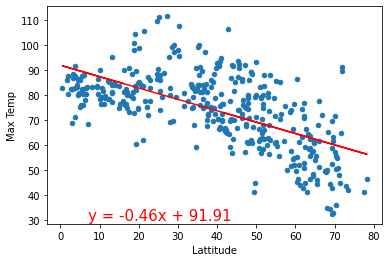

In [23]:
# Calculate the correlation coefficient and linear regression model 
# for Max Temp vs. Latitude Linear Regression in the Northern Hemisphere

# Plot out Max temp versus Lattitude
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Max Temperature (F)")
plt.xlabel('Lattitude')
plt.ylabel('Max Temp')

# Define scatter values for x and y axis
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Max Temperature (F)']

# Compute regression line
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)

# Get y_axis values for the the regression line and add to plot
regress_values = x_values * slope + intercept


plt.plot(x_values,regress_values,"r-")

# Get string with the equation formula and add to plot
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(7,30),fontsize=15,color="red")
plt.savefig("../Images/Northern Hemisphere_Max Temp_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Southern Hemisphere - Max Temp vs. Latitude Linear Regression

The r-value is: 0.6763053756320957


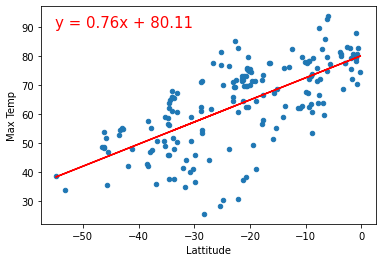

In [24]:
# Calculate the correlation coefficient and linear regression model 
# for Max Temp vs. Latitude Linear Regression in the Southern Hemisphere

# Plot out Max temp versus Lattitude
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Max Temperature (F)")
plt.xlabel('Lattitude')
plt.ylabel('Max Temp')

# Define scatter values for x and y axis
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Max Temperature (F)']

# Compute regression line
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)

# Get y_axis values for the the regression line and add to plot
regress_values = x_values * slope + intercept


plt.plot(x_values,regress_values,"r-")

# Get string with the equation formula and add to plot
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-55,90),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Max Temp_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Northern Hemisphere - Humidity (%) vs. Latitude Linear Regression

The r-value is: -0.05642446535837609


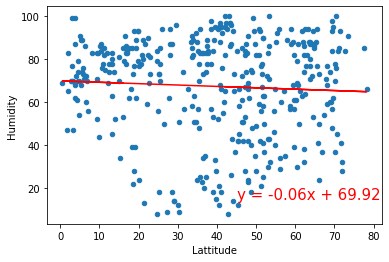

In [25]:
# Calculate the correlation coefficient and linear regression model 
# for Humidity vs. Latitude Linear Regression in the Northern Hemisphere
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Humidity (%)")
plt.xlabel('Lattitude')
plt.ylabel('Humidity')
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Humidity (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(45,15),fontsize=15,color="red")
plt.savefig("../Images/Northern_Hemisphere_Humidity_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Southern Hemisphere - Humidity (%) vs. Latitude Linear Regression

The r-value is: 0.12107725438097942


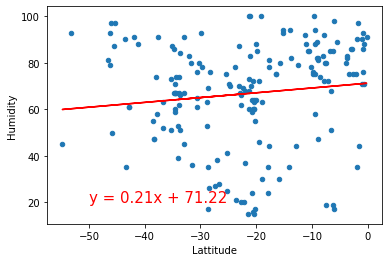

In [26]:
# Calculate the correlation coefficient and linear regression model 
# for Humidity vs. Latitude Linear Regression in the Southern Hemisphere
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Humidity (%)")
plt.xlabel('Lattitude')
plt.ylabel('Humidity')
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Humidity (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-50,20),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Humidity_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Northern Hemisphere - Cloudiness (%) vs. Latitude Linear Regression

The r-value is: -0.08882880388872993


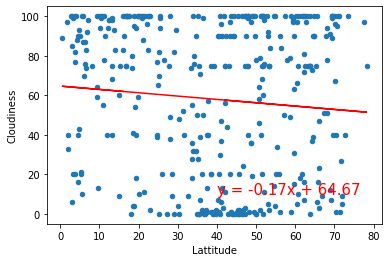

In [27]:
# Calculate the correlation coefficient and linear regression model 
# for Cloudiness (%) vs. Latitude Linear Regression in the Northern Hemisphere
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Cloudiness (%)")
plt.xlabel('Lattitude')
plt.ylabel('Cloudiness')
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Cloudiness (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(40,10),fontsize=15,color="red")
plt.savefig("../Images/Northern_Hemisphere_Cloudiness_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Southern Hemisphere - Cloudiness (%) vs. Latitude Linear Regression

The r-value is: 0.052514931179237695


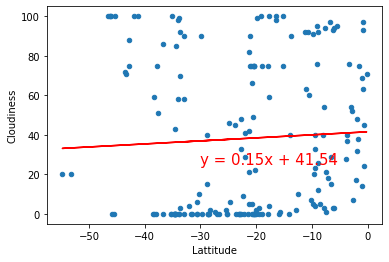

In [28]:
# Calculate the correlation coefficient and linear regression model 
# for Cloudiness (%) vs. Latitude Linear Regression in the Southern Hemisphere
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Cloudiness (%)")
plt.xlabel('Lattitude')
plt.ylabel('Cloudiness')
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Cloudiness (%)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-30,25),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Cloudiness_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Northern Hemisphere - Wind Speed (mph) vs. Latitude Linear Regression

The r-value is: -0.029111116193931492


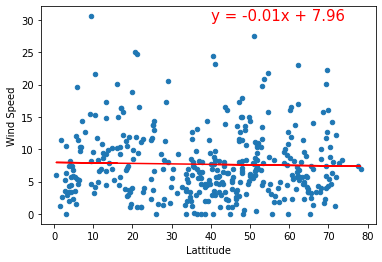

In [29]:
# Calculate the correlation coefficient and linear regression model 
# for Wind Speed (mph) vs. Latitude Linear Regression in the Northern Hemisphere
regression_nh_df.plot(kind="scatter", x="Lattitude", y="Wind Speed (mph)")
plt.xlabel('Lattitude')
plt.ylabel('Wind Speed')
x_values = regression_nh_df['Lattitude']
y_values = regression_nh_df['Wind Speed (mph)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(40,30),fontsize=15,color="red")
plt.savefig("../Images/Northern_Hemisphere_Cloudiness_(%)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()

####  Southern Hemisphere - Wind Speed (mph) vs. Latitude Linear Regression

The r-value is: -0.0951146807114889


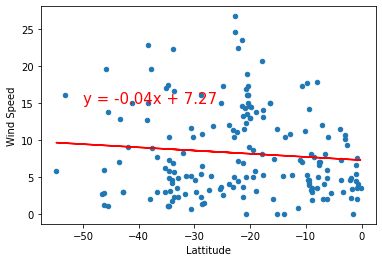

In [30]:
# Calculate the correlation coefficient and linear regression model 
# for Wind Speed (mph) vs. Latitude Linear Regression in the Southern Hemisphere
regression_sh_df.plot(kind="scatter", x="Lattitude", y="Wind Speed (mph)")
plt.xlabel('Lattitude')
plt.ylabel('Wind Speed')
x_values = regression_sh_df['Lattitude']
y_values = regression_sh_df['Wind Speed (mph)']
slope, intercept, rvalue, pvalue, stderr = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
plt.plot(x_values,regress_values,"r-")
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.annotate(line_eq,(-50,15),fontsize=15,color="red")
plt.savefig("../Images/Southern_Hemisphere_Wind_Speed_(mph)_vs._Latitude_Linear_Regression.png", bbox_inches = "tight")
print(f"The r-value is: {rvalue}")
plt.show()